<a href="https://colab.research.google.com/github/mobarakol/tutorial_notebooks/blob/main/stable_diffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Stable Diffusion Model
src: https://github.com/woctezuma/stable-diffusion-colab<br>
other src: https://github.com/CompVis/stable-diffusion<br>
paper: https://arxiv.org/abs/2112.10752<br>
paper:  Stable Diffusion Safety Filter (https://arxiv.org/pdf/2210.04610.pdf)


In [1]:
%pip install --quiet --upgrade diffusers transformers scipy mediapy accelerate ftfy spacy

     |████████████████████████████████| 453 kB 16.8 MB/s 
     |████████████████████████████████| 5.8 MB 23.0 MB/s 
     |████████████████████████████████| 33.8 MB 211 kB/s 
     |████████████████████████████████| 191 kB 58.0 MB/s 
     |████████████████████████████████| 53 kB 398 kB/s 
     |████████████████████████████████| 182 kB 14.1 MB/s 
     |████████████████████████████████| 7.6 MB 68.0 MB/s 
     |████████████████████████████████| 1.6 MB 46.8 MB/s 


In [2]:
import subprocess

# The xformers package is mandatory to be able to create several 768x768 images.
github_url = "https://github.com/TheLastBen/fast-stable-diffusion"
xformers_wheels = "xformers-0.0.13.dev0-py3-none-any.whl"

# Obtain GPU info

nvidia_output = subprocess.run(['nvidia-smi', '-q'], capture_output=True).stdout

gpu_info = [
    str(line) for line in str(nvidia_output).split('\\n')
    if "Product Name" in line
    ]

print(gpu_info)

# Identify your GPU

gpu_name = None

for gpu_test in ['A100', 'K80', 'P100', 'T4', 'V100']:
  if any(gpu_test in line for line in gpu_info):
    gpu_name = gpu_test
    break

# Install xformers using pre-compiled Python wheels
%pip install -q {github_url}/raw/main/precompiled/{gpu_name}/{xformers_wheels}

['    Product Name                          : Tesla T4']
     |████████████████████████████████| 100.8 MB 77 kB/s 


In [3]:
# model_id = "stabilityai/stable-diffusion-2-base"
model_id = "stabilityai/stable-diffusion-2"

In [4]:
from diffusers import PNDMScheduler, DDIMScheduler, LMSDiscreteScheduler, EulerDiscreteScheduler

# scheduler = PNDMScheduler.from_pretrained(model_id, subfolder="scheduler")
# scheduler = DDIMScheduler.from_pretrained(model_id, subfolder="scheduler")
# scheduler = LMSDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
scheduler = EulerDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")

Downloading:   0%|          | 0.00/345 [00:00<?, ?B/s]

In [5]:
import mediapy as media
import torch
from diffusers import StableDiffusionPipeline

device = "cuda"

pipe = StableDiffusionPipeline.from_pretrained(
    model_id,
    scheduler=scheduler,
    torch_dtype=torch.float16,
    revision="fp16",
    )
pipe = pipe.to(device)
pipe.enable_xformers_memory_efficient_attention()

if model_id.endswith('-base'):
  image_length = 512
else:
  image_length = 768



Downloading:   0%|          | 0.00/511 [00:00<?, ?B/s]

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

Downloading:   0%|          | 0.00/624 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/681M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/525k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/460 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/815 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/900 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.73G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/602 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/167M [00:00<?, ?B/s]

  0%|          | 0/25 [00:00<?, ?it/s]

,,,

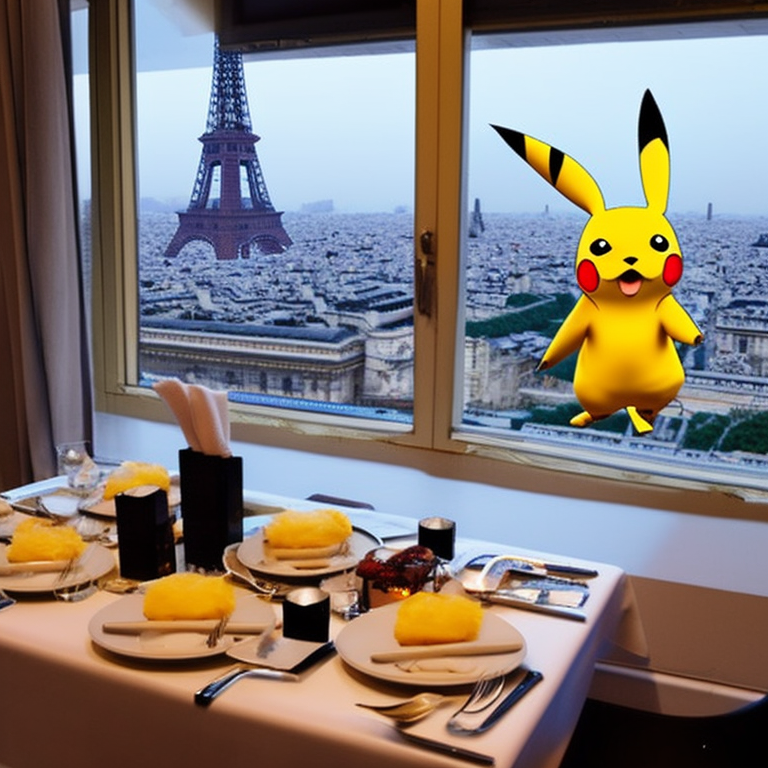
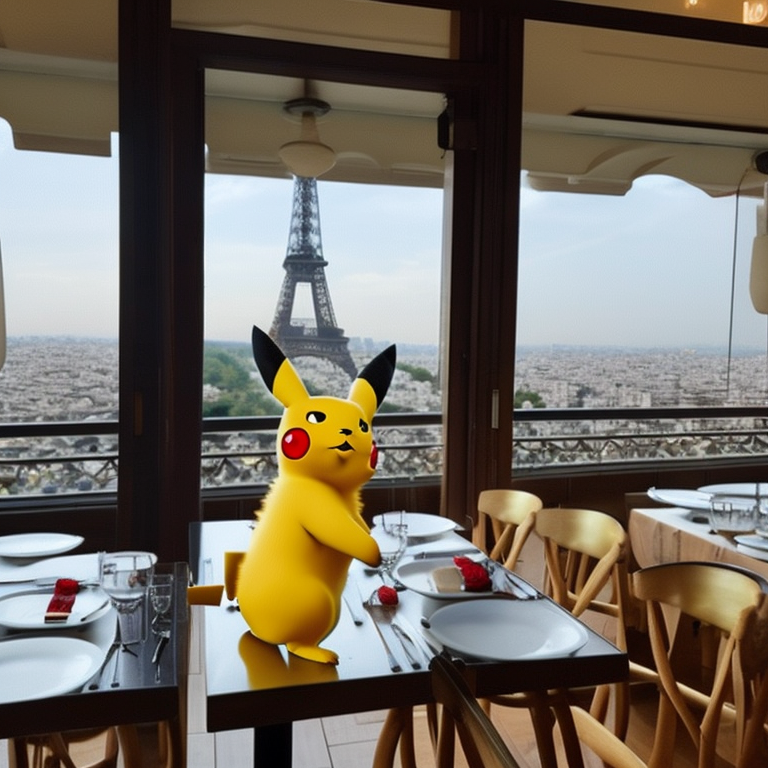
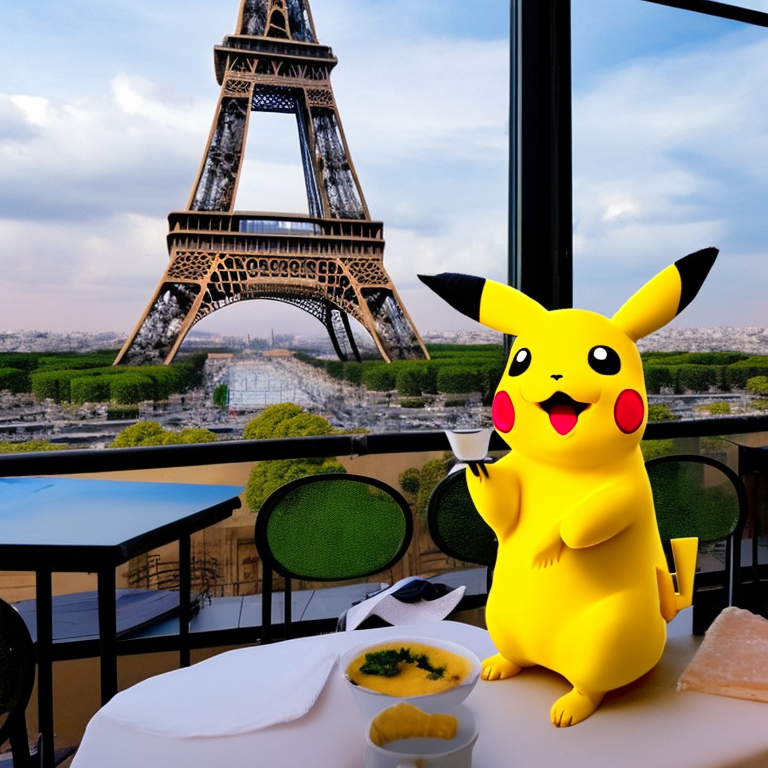
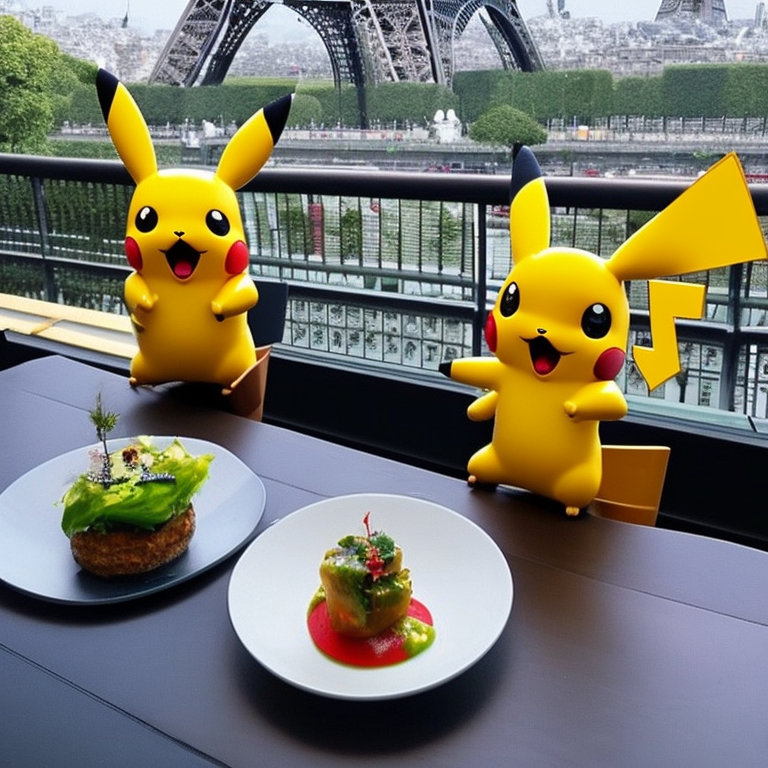

In [6]:
prompt = "A pikachu fine dining with a view to the Eiffel Tower"
num_images = 4

images = pipe(
    prompt,
    num_images_per_prompt=num_images,
    guidance_scale=9,
    num_inference_steps=25,
    height=image_length,
    width=image_length,
    ).images
    
media.show_images(images)
images[0].save("output.jpg")

  0%|          | 0/25 [00:00<?, ?it/s]

,,,

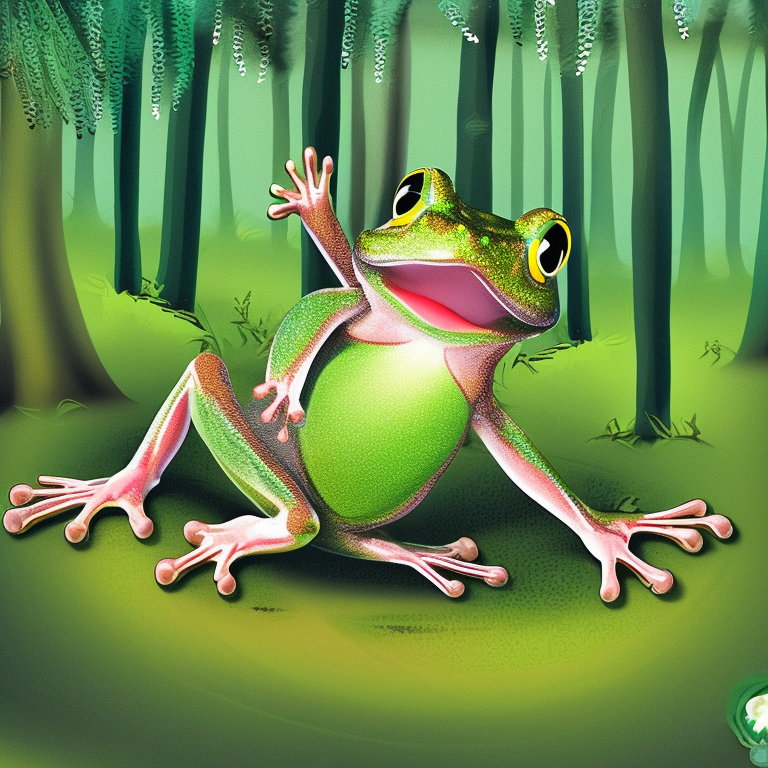
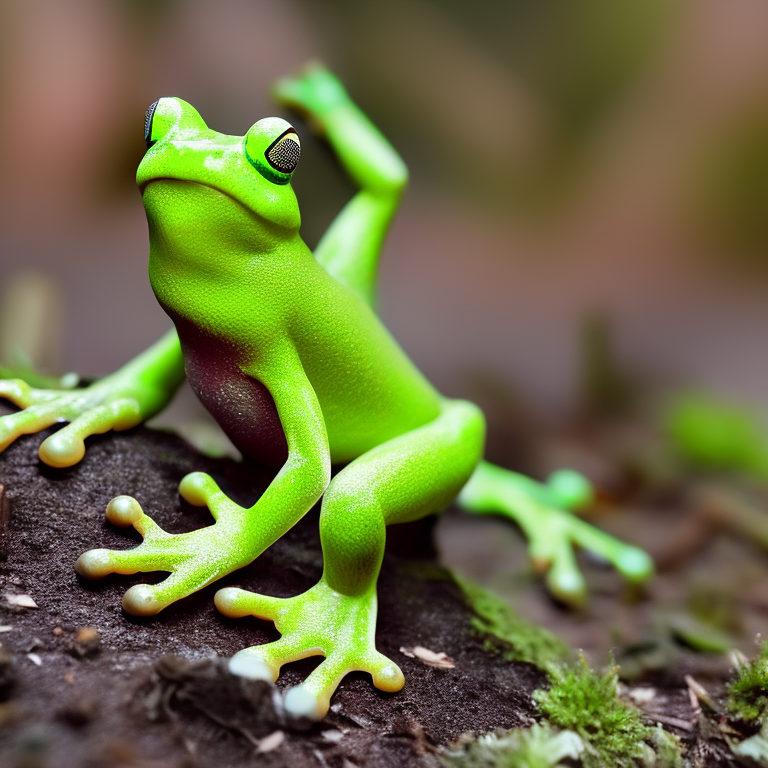
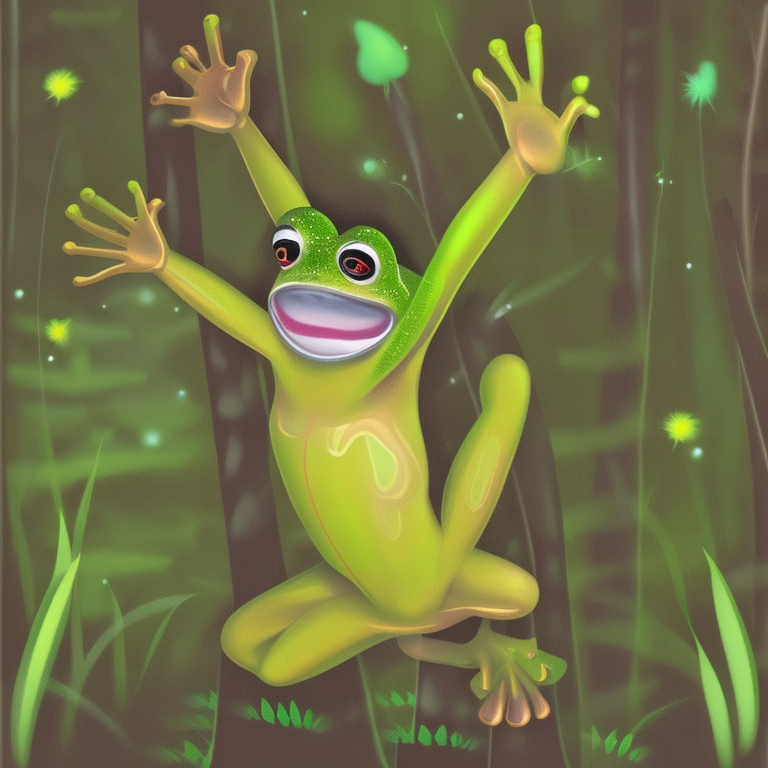
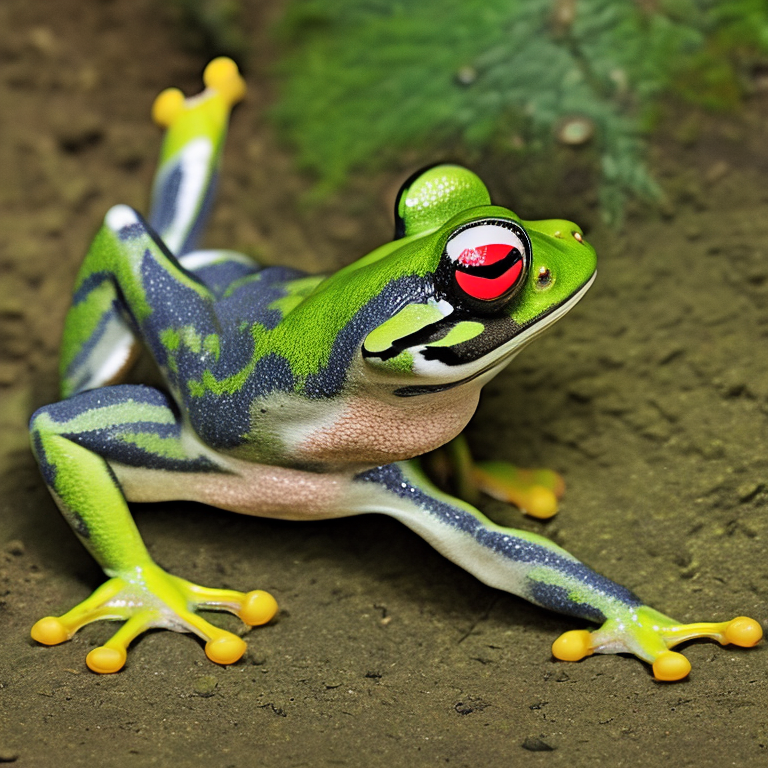

In [7]:
prompt = "Dancing frog on the forest"
num_images = 4

images = pipe(
    prompt,
    num_images_per_prompt=num_images,
    guidance_scale=9,
    num_inference_steps=25,
    height=image_length,
    width=image_length,
    ).images
    
media.show_images(images)
images[0].save("output.jpg")

  0%|          | 0/25 [00:00<?, ?it/s]

,,,

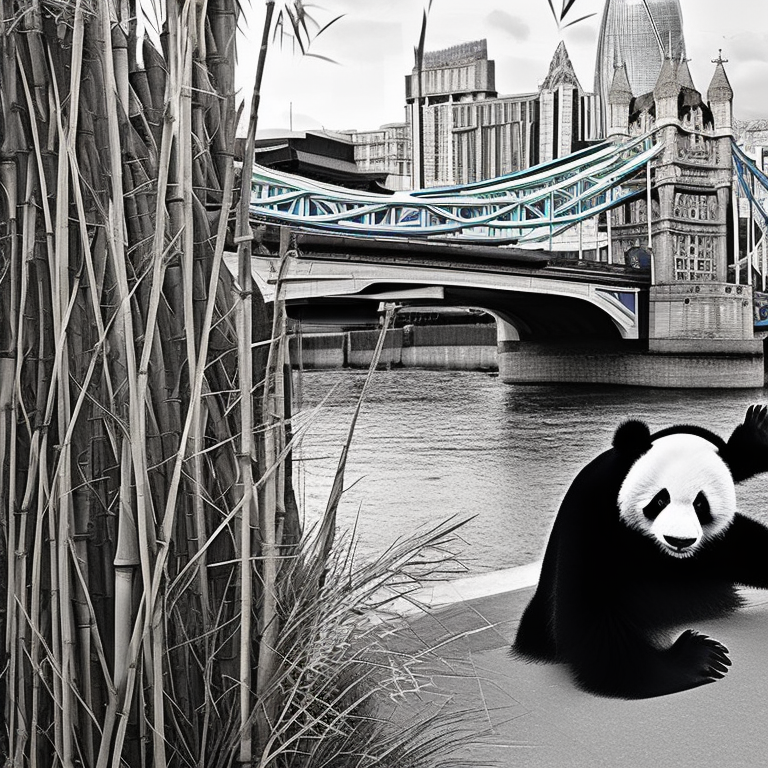
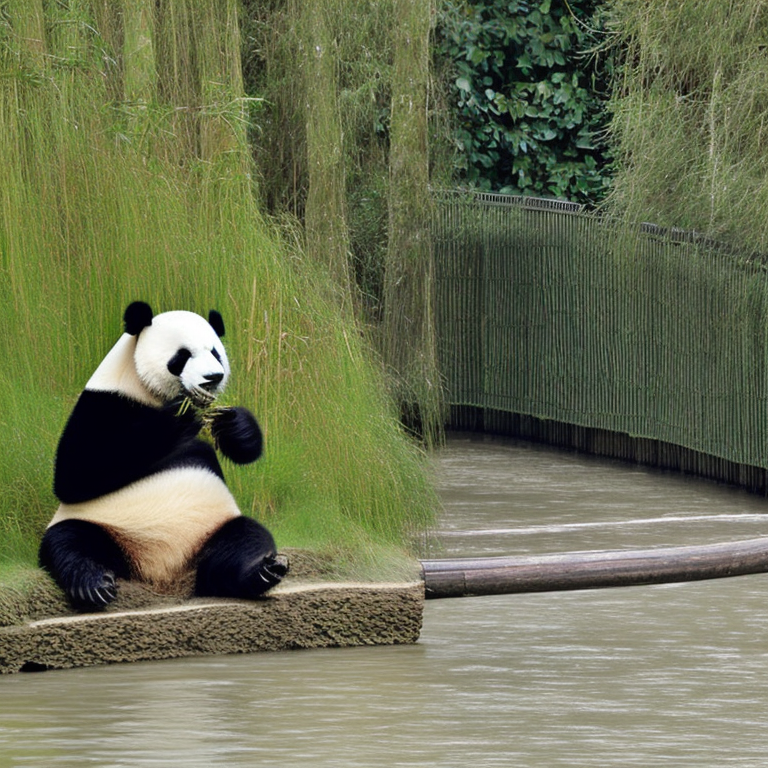
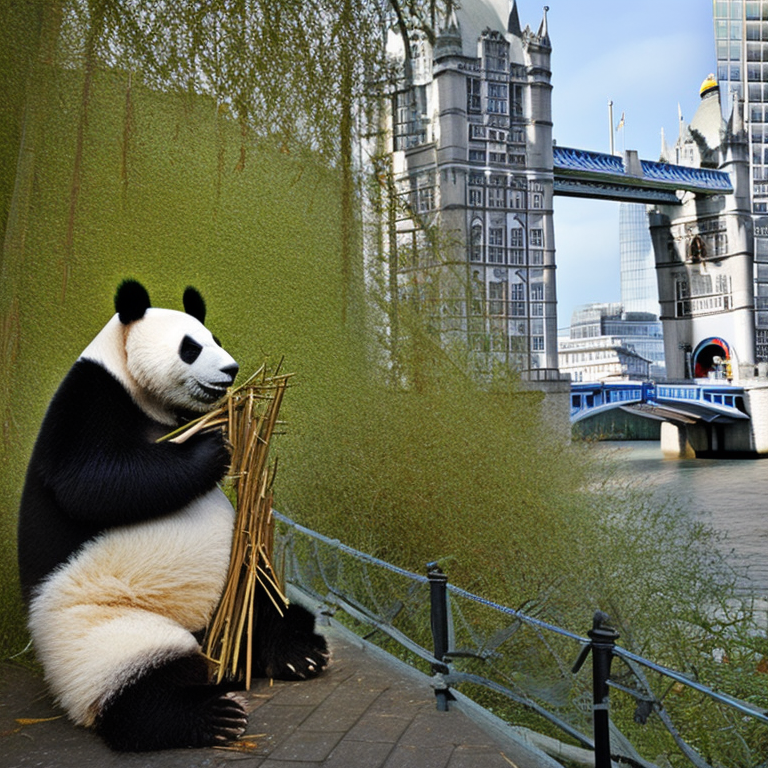
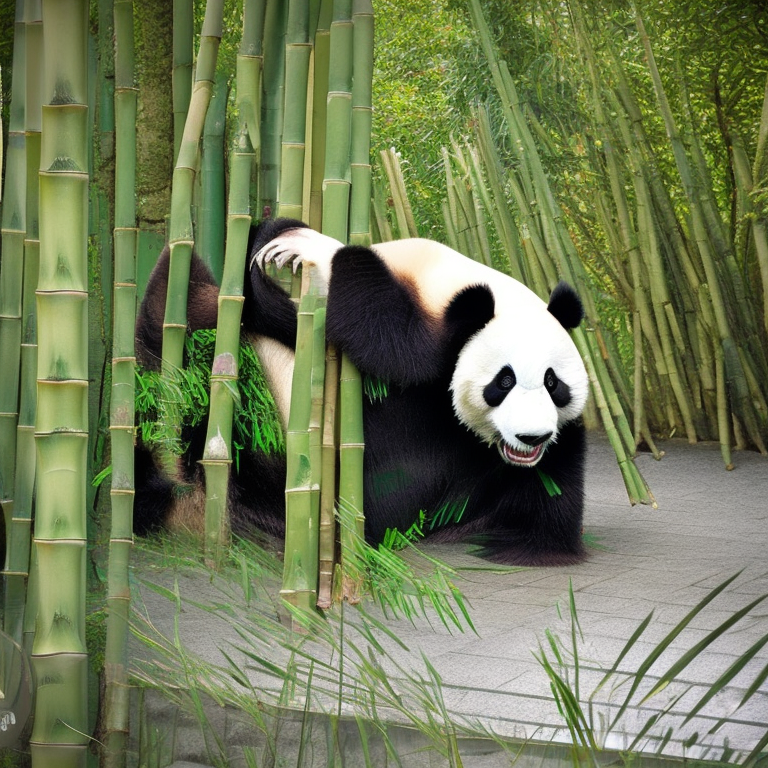

In [9]:
prompt = "London bridge and Giant panda eating bamboo"
num_images = 4

images = pipe(
    prompt,
    num_images_per_prompt=num_images,
    guidance_scale=9,
    num_inference_steps=25,
    height=image_length,
    width=image_length,
    ).images
    
media.show_images(images)
images[0].save("output.jpg")

  0%|          | 0/25 [00:00<?, ?it/s]

,,,

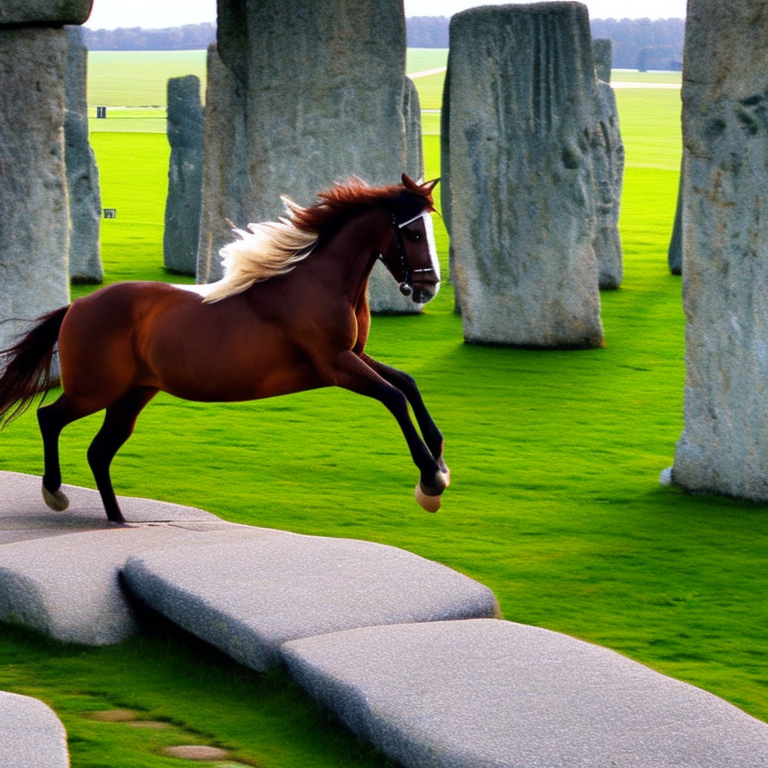
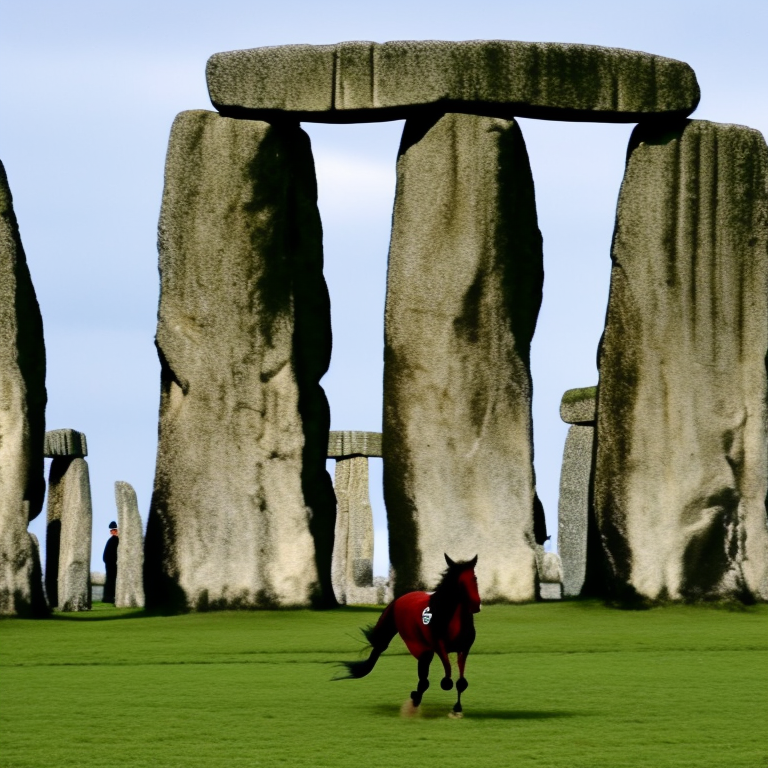
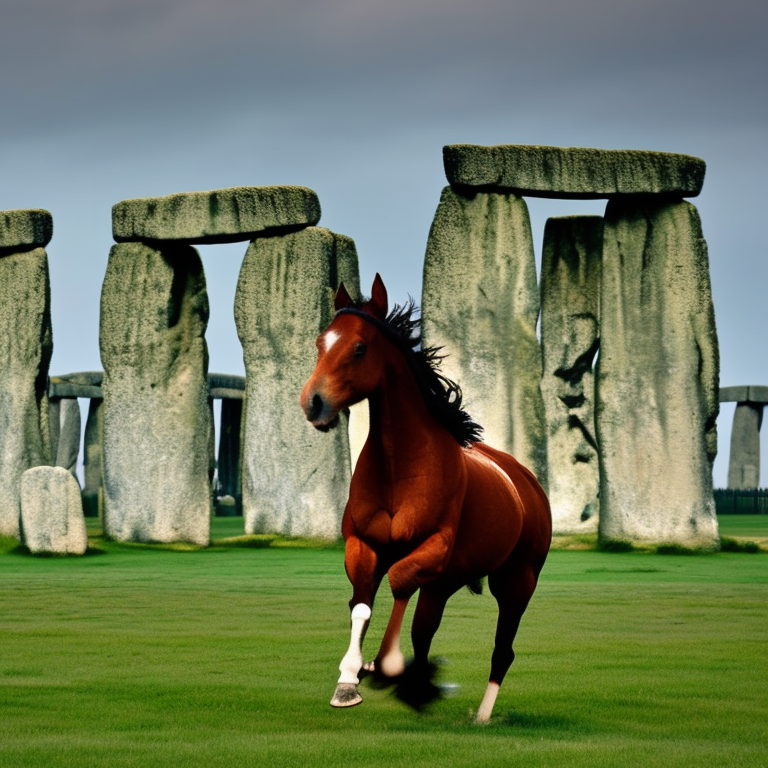
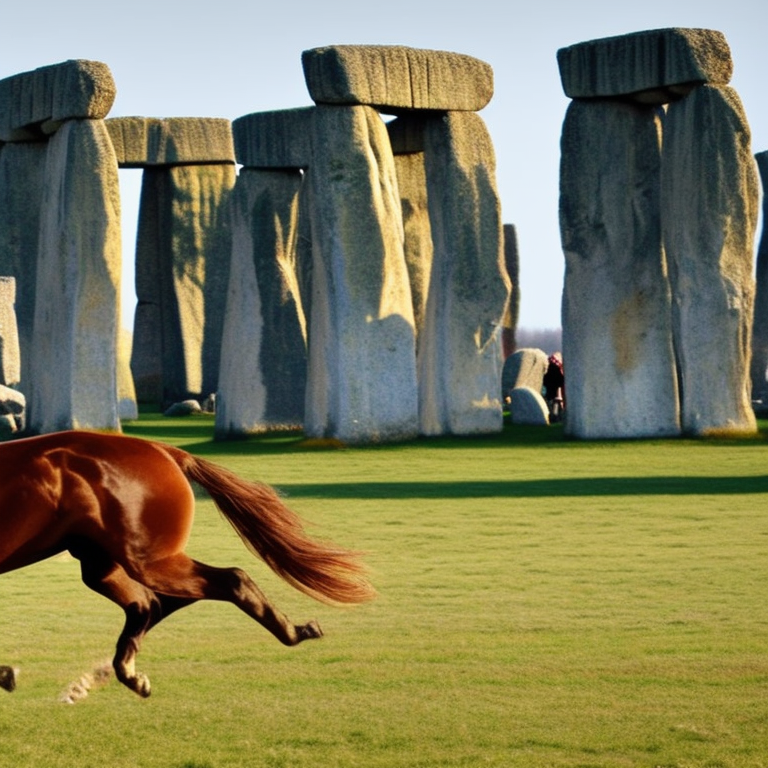

In [10]:
prompt = "Horse running in Stonehenge"
num_images = 4

images = pipe(
    prompt,
    num_images_per_prompt=num_images,
    guidance_scale=9,
    num_inference_steps=25,
    height=image_length,
    width=image_length,
    ).images
    
media.show_images(images)
images[0].save("output.jpg")